In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
roads = pd.read_csv('..//roads//roads.csv')
roads.head()

,lat_,lon_,State_,Ta_mean,Ta_min,Ta_max,Tsurf_mean,Tsurf_min,Tsurf_max,Water_mean,...,Tdew_mean,Tdew_min,Tdew_max,Friction_mean,Friction_min,Friction_max,Date_<lambda>,Time(+01:00)_min,Direction_min,Direction_max
0,68.0926,16.3644,3,14.1,14.1,14.1,1.675000,1.61,1.74,0.092000,...,NaN,NaN,NaN,0.73,0.73,0.73,2020.12.22,12:05:56,273.7,282.4
1,68.0926,16.3645,3,14.1,14.1,14.1,1.787778,1.55,1.98,0.105778,...,NaN,NaN,NaN,0.73,0.73,0.73,2020.12.22,12:05:47,275.5,285.1
2,68.0926,16.3646,3,14.1,14.1,14.1,2.050000,2.05,2.05,0.088000,...,NaN,NaN,NaN,0.72,0.72,0.72,2020.12.22,12:05:46,286.1,286.1
3,68.0926,16.3647,3,14.1,14.1,14.1,1.920000,1.92,1.92,0.108000,...,NaN,NaN,NaN,0.72,0.72,0.72,2020.12.22,12:05:45,288.3,288.3
4,68.0926,16.3648,3,14.1,14.1,14.1,1.550000,1.55,1.55,0.094000,...,NaN,NaN,NaN,0.71,0.71,0.71,2020.12.22,12:05:44,290.0,290.0


In [4]:
roads.shape

(196133, 28)

### Соотношение между численными метками State и смысловыми

In [5]:
states_str = ['dry', 'moist', 'wet', 'icy', 'snowy', 'slushy']
state_encode = {i: states_str[i-1] for i in range(1, 7)}
state_encode

{1: 'dry', 2: 'moist', 3: 'wet', 4: 'icy', 5: 'snowy', 6: 'slushy'}

In [6]:
roads = roads.rename(columns = {'Date_<lambda>': 'Date', 'Time(+01:00)_min': 'Time'})

Как преобразовывался исходный датасет:
- В признаках Latitude и Longitude дробную часть округлили до 4-ёх знаков
- Затем сгруппировали наблюдения по получившимся признакам, при этом
-- Для признаков Ta, Tsurf, Water, Speed, Height, Tdew, Friction вычислены в группах min, max и mean (пока что так, потом отбросим лишние)
-- Для признака Direction отобраны min и max в группах (в каком-то смысле можем описать сектор, в котором дул ветер)

In [7]:
roads.columns

Index(['lat_', 'lon_', 'State_', 'Ta_mean', 'Ta_min', 'Ta_max', 'Tsurf_mean',
       'Tsurf_min', 'Tsurf_max', 'Water_mean', 'Water_min', 'Water_max',
       'Speed_mean', 'Speed_min', 'Speed_max', 'Height_mean', 'Height_min',
       'Height_max', 'Tdew_mean', 'Tdew_min', 'Tdew_max', 'Friction_mean',
       'Friction_min', 'Friction_max', 'Date', 'Time', 'Direction_min',
       'Direction_max'],
      dtype='object')

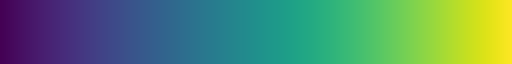

In [10]:
sns.color_palette("viridis", as_cmap=True)

Здесь с помощью WorldWeatherOnline API берём данные о погоде с метеостанции в Нарвике за интересующий период. Самый мелкий шаг по времени между соседними измерениями --- 1 час (frequency = 1)

In [4]:
import plotly.express as px
color_scale = [(0, 'orange'), (1,'red')]
fig = px.scatter_mapbox(roads,
                        lat="lat_",
                        lon="lon_",
                        hover_data=["lat_", "lon_"],
                        color_continuous_scale=color_scale,
                        #size=10,
                        zoom=8,
                        height=800,
                        width=800)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [13]:
from wwo_hist import retrieve_hist_data

In [75]:
location_list = ['ballangen', 'bjerkvik', 'hakvik', 'kjopsvik', 'narvik', 'oyjord',
                 'straumsnes', 'ulvik']
location_coord = np.array([
    [68.34299475653074, 16.831685432708383],
    [68.5498825034639, 17.557895548083486],
    [68.40431941400827, 17.31039640806505],
    [68.09465830192292, 16.370181549647725],
    [68.44039283115124, 17.415505119668627],
    [68.47105696193863, 17.503711330201476],
    [68.43734270998274, 17.65530957686416],
    [68.24379661112127, 16.34603674589545]
], dtype=float)

In [85]:
frequency=1
start_date = '29-NOV-2020'
end_date = '3-MAR-2021'
api_key = 'a0b1dba6b7124a6c8d9132524222310'
wwo_data = retrieve_hist_data(api_key,
                                location_list,
                                start_date,
                                end_date,
                                frequency,
                                location_label = False,
                                export_csv = True,
                                store_df = True)



Retrieving weather data for ballangen


Currently retrieving data for ballangen: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.275927
Currently retrieving data for ballangen: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.265925
Currently retrieving data for ballangen: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.156266
Currently retrieving data for ballangen: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:02.886943
Currently retrieving data for ballangen: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:03.161034


export ballangen completed!




Retrieving weather data for bjerkvik


Currently retrieving data for bjerkvik: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.355228
Currently retrieving data for bjerkvik: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.282513
Currently retrieving data for bjerkvik: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.289882
Currently retrieving data for bjerkvik: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:03.169549
Currently retrieving data for bjerkvik: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:03.449722


export bjerkvik completed!




Retrieving weather data for hakvik


Currently retrieving data for hakvik: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.528592
Currently retrieving data for hakvik: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.736270
Currently retrieving data for hakvik: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.522960
Currently retrieving data for hakvik: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:03.553591
Currently retrieving data for hakvik: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:03.820832


export hakvik completed!




Retrieving weather data for kjopsvik


Currently retrieving data for kjopsvik: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.251686
Currently retrieving data for kjopsvik: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.036480
Currently retrieving data for kjopsvik: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:01.812968
Currently retrieving data for kjopsvik: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:02.620228
Currently retrieving data for kjopsvik: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:02.903617


export kjopsvik completed!




Retrieving weather data for narvik


Currently retrieving data for narvik: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.238779
Currently retrieving data for narvik: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.031069
Currently retrieving data for narvik: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.021671
Currently retrieving data for narvik: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:02.697120
Currently retrieving data for narvik: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:02.954177


export narvik completed!




Retrieving weather data for oyjord


Currently retrieving data for oyjord: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.288211
Currently retrieving data for oyjord: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.165609
Currently retrieving data for oyjord: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:01.960628
Currently retrieving data for oyjord: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:02.683538
Currently retrieving data for oyjord: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:02.924315


export oyjord completed!




Retrieving weather data for straumsnes


Currently retrieving data for straumsnes: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.240603
Currently retrieving data for straumsnes: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.125530
Currently retrieving data for straumsnes: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.132506
Currently retrieving data for straumsnes: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:02.846289
Currently retrieving data for straumsnes: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:03.083462


export straumsnes completed!




Retrieving weather data for ulvik


Currently retrieving data for ulvik: from 2020-11-29 to 2020-11-30


C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:69: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.

C:\ifmo\AlgoAnalysisDevelopment\venv\Scripts\lib\site-packages\wwo_hist\__init__.py:74: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



Time elapsed (hh:mm:ss.ms) 0:00:00.249553
Currently retrieving data for ulvik: from 2020-12-01 to 2020-12-31
Time elapsed (hh:mm:ss.ms) 0:00:01.257540
Currently retrieving data for ulvik: from 2021-01-01 to 2021-01-31
Time elapsed (hh:mm:ss.ms) 0:00:02.266565
Currently retrieving data for ulvik: from 2021-02-01 to 2021-02-28
Time elapsed (hh:mm:ss.ms) 0:00:03.168782
Currently retrieving data for ulvik: from 2021-03-01 to 2021-03-03
Time elapsed (hh:mm:ss.ms) 0:00:03.423698


export ulvik completed!




In [86]:
wwo_data = pd.concat([pd.read_csv(city + '.csv') for city in location_list])

In [87]:
wwo_data[wwo_data['location'] == 'narvik'].head()

,date_time,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,moonrise,moonset,sunrise,...,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,location
0,2020-11-29 00:00:00,2,-8,0.0,0.3,1,94,02:25 PM,09:11 AM,11:33 AM,...,30,96,89,0.9,1020,-2,7,173,14,narvik
1,2020-11-29 01:00:00,2,-8,0.0,0.3,1,94,02:25 PM,09:11 AM,11:33 AM,...,30,97,90,0.4,1020,-2,7,176,14,narvik
2,2020-11-29 02:00:00,2,-8,0.0,0.3,1,94,02:25 PM,09:11 AM,11:33 AM,...,30,99,91,0.5,1020,-2,8,178,14,narvik
3,2020-11-29 03:00:00,2,-8,0.0,0.3,1,94,02:25 PM,09:11 AM,11:33 AM,...,30,100,92,0.7,1020,-2,9,181,14,narvik
4,2020-11-29 04:00:00,2,-8,0.0,0.3,1,94,02:25 PM,09:11 AM,11:33 AM,...,30,100,92,0.3,1020,-2,9,177,14,narvik


In [88]:
for city in location_list:
    print((city, wwo_data[wwo_data['location'] == city]['date_time'].describe()))

('ballangen', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('bjerkvik', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('hakvik', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('kjopsvik', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('narvik', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('oyjord', count                    2280
unique                   2280
top       2020-11-29 00:00:00
freq                        1
Name: date_time, dtype: object)
('straumsnes', 

In [89]:
for city in location_list:
    print((city, wwo_data[wwo_data['location'] == city].describe()))

('ballangen',           maxtempC     mintempC  totalSnow_cm      sunHour      uvIndex  \
count  2280.000000  2280.000000   2280.000000  2280.000000  2280.000000   
mean     -3.157895    -7.557895      1.213684     1.864211     1.431579   
std       3.975305     4.427484      2.331656     2.105189     0.495405   
min     -11.000000   -19.000000      0.000000     0.000000     1.000000   
25%      -7.000000   -11.000000      0.000000     0.000000     1.000000   
50%      -3.000000    -8.000000      0.000000     1.300000     1.000000   
75%       0.000000    -5.000000      1.800000     3.500000     2.000000   
max       5.000000     2.000000     10.200000     8.600000     2.000000   

       moon_illumination    DewPointC   FeelsLikeC   HeatIndexC   WindChillC  \
count        2280.000000  2280.000000  2280.000000  2280.000000  2280.000000   
mean           52.431579    -6.903070    -7.152193    -4.271491    -7.152193   
std            29.435640     4.939901     4.695754     4.098874     4.

In [81]:
def getDateTime(row):
    return '-'.join(row['Date'].split('.')) + " " + row['Time'].split(':')[0] + ":00:00"


roads['FullDate'] = roads.apply(lambda row: getDateTime(row), axis=1)

In [52]:
def closeloc(row):
    res = np.apply_along_axis(lambda x: (x[0] - row['lat_'])**2 + (x[1]-row['lon_'])**2,
                              axis=1,
                              arr = location_coord)
    return location_list[np.where(res == res.min())[0][0]]

In [82]:
roads['ClosestCity'] = roads.apply(lambda row: closeloc(row), axis=1)

In [83]:
roads.head()

,lat_,lon_,State_,Ta_mean,Ta_min,Ta_max,Tsurf_mean,Tsurf_min,Tsurf_max,Water_mean,...,Tdew_max,Friction_mean,Friction_min,Friction_max,Date,Time,Direction_min,Direction_max,FullDate,ClosestCity
0,68.0926,16.3644,3,14.1,14.1,14.1,1.675000,1.61,1.74,0.092000,...,NaN,0.73,0.73,0.73,2020.12.22,12:05:56,273.7,282.4,2020-12-22 12:00:00,kjopsvik
1,68.0926,16.3645,3,14.1,14.1,14.1,1.787778,1.55,1.98,0.105778,...,NaN,0.73,0.73,0.73,2020.12.22,12:05:47,275.5,285.1,2020-12-22 12:00:00,kjopsvik
2,68.0926,16.3646,3,14.1,14.1,14.1,2.050000,2.05,2.05,0.088000,...,NaN,0.72,0.72,0.72,2020.12.22,12:05:46,286.1,286.1,2020-12-22 12:00:00,kjopsvik
3,68.0926,16.3647,3,14.1,14.1,14.1,1.920000,1.92,1.92,0.108000,...,NaN,0.72,0.72,0.72,2020.12.22,12:05:45,288.3,288.3,2020-12-22 12:00:00,kjopsvik
4,68.0926,16.3648,3,14.1,14.1,14.1,1.550000,1.55,1.55,0.094000,...,NaN,0.71,0.71,0.71,2020.12.22,12:05:44,290.0,290.0,2020-12-22 12:00:00,kjopsvik


Здесь же мержим преобразованный датасет с измерениями с метеостанции

In [91]:
extended_data = pd.merge(left = roads, right = wwo_data, left_on=['FullDate', 'ClosestCity'], right_on=['date_time', 'location'], how='inner')
extended_data.head()

,lat_,lon_,State_,Ta_mean,Ta_min,Ta_max,Tsurf_mean,Tsurf_min,Tsurf_max,Water_mean,...,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,location
0,68.0926,16.3644,3,14.1,14.1,14.1,1.675000,1.61,1.74,0.092000,...,36,63,69,0.0,1000,-5,10,152,17,kjopsvik
1,68.0926,16.3645,3,14.1,14.1,14.1,1.787778,1.55,1.98,0.105778,...,36,63,69,0.0,1000,-5,10,152,17,kjopsvik
2,68.0926,16.3646,3,14.1,14.1,14.1,2.050000,2.05,2.05,0.088000,...,36,63,69,0.0,1000,-5,10,152,17,kjopsvik
3,68.0926,16.3647,3,14.1,14.1,14.1,1.920000,1.92,1.92,0.108000,...,36,63,69,0.0,1000,-5,10,152,17,kjopsvik
4,68.0926,16.3648,3,14.1,14.1,14.1,1.550000,1.55,1.55,0.094000,...,36,63,69,0.0,1000,-5,10,152,17,kjopsvik


In [92]:
extended_data.shape

(196133, 55)

In [95]:
extended_data_dropped = extended_data.drop(columns=['date_time', 'FullDate', 'location'])
extended_data_dropped.shape

(196133, 52)

In [93]:
#extended_data.to_csv('fulldata.csv')

In [96]:
np.random.seed(42)
subsample1 = extended_data_dropped.sample(n = 1000)

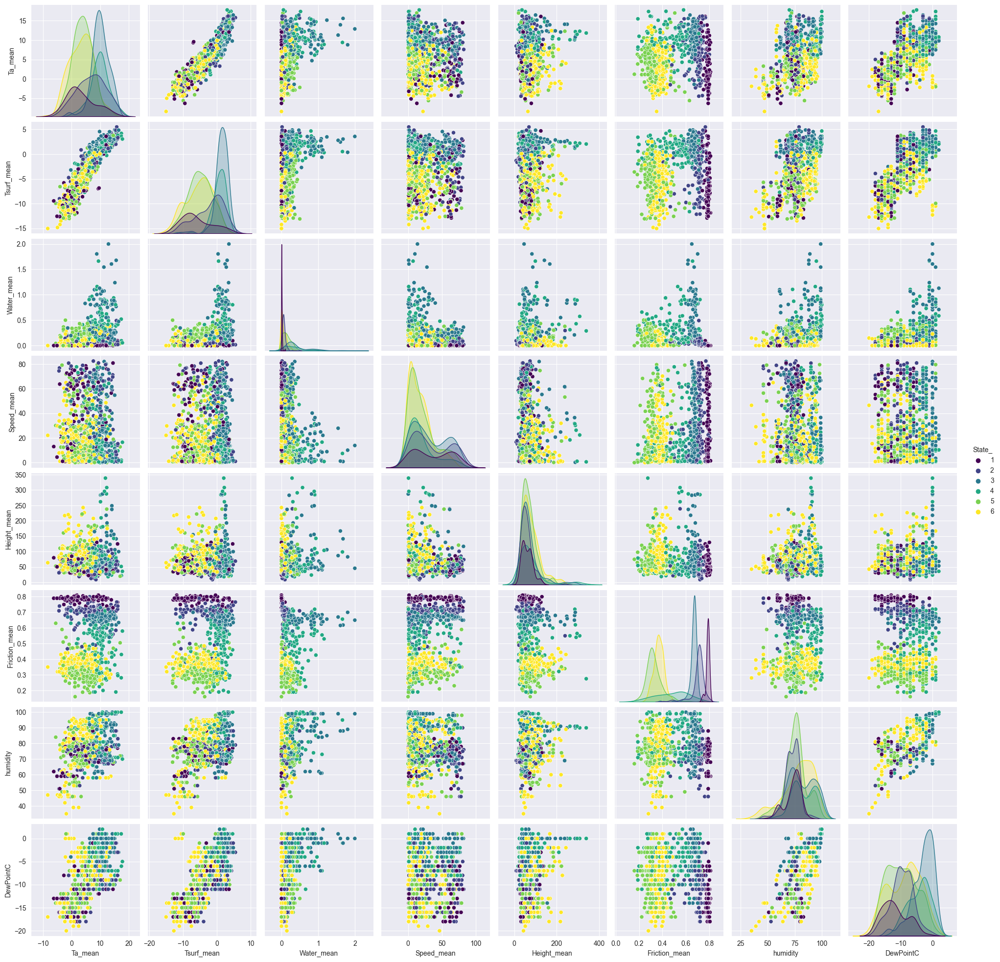

In [97]:
sns.pairplot(data = subsample1[['State_', 'Ta_mean', 'Tsurf_mean', 'Water_mean', 'Speed_mean', 'Height_mean', 'Friction_mean', 'humidity', 'DewPointC']], hue='State_', palette='viridis')